## Implementation of 
# *Hyperspectral Unmixing Using Orthogonal Sparse Prior-Based Autoencoder With Hyper-Laplacian Loss and Data-Driven Outlier Detection*
Z. Dou, K. Gao, X. Zhang, H. Wang and J. Wang, "Hyperspectral Unmixing Using Orthogonal Sparse Prior-Based Autoencoder With Hyper-Laplacian Loss and Data-Driven Outlier Detection," in IEEE Transactions on Geoscience and Remote Sensing, vol. 58, no. 9, pp. 6550-6564, Sept. 2020, doi: 10.1109/TGRS.2020.2977819.

### Loss is given by 
$$E = \|\bf{X}-\bf{R}\|_p^p-\sum_i\log\left(\frac{\bf{R}_i\cdot\bf{X}_i}{\|(\bf{W}\bf{H})_i\|_2\|\bf{X}_i\|_2}\right) + \rho_1 L_\text{OSP}+\rho_2\sum_i L_1(\bf{h_i})-\rho_3 S(M_{W_{<0}}\odot W)+\rho_4 S(M_{W_{>0}}\odot W)$$
where
$$L_\text{OSP}(B)=\sum_{i<j}\frac{\bf{B_i}\cdot\bf{B_j}}{\|\bf{B}_i\|_2\|\bf{B}_j\|_2}$$

### Imports

In [1]:
import tensorflow as tf
from tensorflow.keras import initializers, constraints, layers, activations, regularizers
from tensorflow.python.ops import math_ops
from tensorflow.python.keras import backend as K
from tensorflow.python.framework import tensor_shape
from unmixing import HSI, plotEndmembers,SAD, vca
from unmixing import plotEndmembersAndGT, plotAbundancesSimple, load_HSI, PlotWhileTraining
from scipy import io as sio
import os
import numpy as np
from numpy.linalg import inv
import warnings
import matplotlib
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
%matplotlib inline

### Use CPU

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

## Method OSP
method that implements 
$$L_\text{OSP}(B)=\sum_{i<j}\frac{\bf{B_i}\cdot\bf{B_j}}{\|\bf{B}_i\|_2\|\bf{B}_j\|_2}$$
This makes abundance maps mutually orthogonal

In [3]:
def OSP(B,R):
    dots = 0.0
    B = tf.linalg.l2_normalize(B,axis=0)
    for i in range(R):
        for j in range(i+1,R):
            A1 = B[:,i]
            A2 = B[:,j]
            dot = tf.reduce_sum(A1*A2,axis=0)
            dots = dots + dot
    return dots

## Class SumToOne
Also performs regularizations l1 and OSP 
$$L_\text{OSP}+\rho_2\sum_i L_1(\bf{h_i})$$

In [4]:
class SumToOne(layers.Layer):
    def __init__(self, params, **kwargs):
        super(SumToOne, self).__init__(**kwargs)
        self.num_outputs = params['num_endmembers']
        self.params = params
        
    def l1_regularization(self,x):
        l1 = tf.reduce_sum(tf.pow(tf.abs(x)+1e-8,0.7))
        return self.params['l1'] * l1
    
    def osp_regularization(self,x):
        return self.params['osp']*OSP(x,self.params['num_endmembers'])
        
    def call(self, x):
        x = tf.nn.softmax(self.params['scale'] * x)
        self.add_loss(self.l1_regularization(x))
        self.add_loss(self.osp_regularization(x))
        return x

## Class NonNegLessOne
Kernel regularizer to keep weights in range 0 to 1. Implements 
$$-\rho_3 S(M_{W_{<0}}\odot W)+\rho_4 S(M_{W_{>0}}\odot W)$$

In [5]:
class NonNegLessOne(regularizers.Regularizer):
    def __init__(self, strength):
        super(NonNegLessOne,self).__init__()
        self.strength = strength

    def __call__(self, x):
        neg = tf.cast(x < 0, x.dtype) * x
        greater_one = tf.cast(x>=1.0, x.dtype)*x
        reg = -self.strength * tf.reduce_sum(neg)+self.strength*tf.reduce_sum(greater_one)
        return reg

## Class HyperLaplacianLoss
Calculates the Hyper Laplacian loss
$$\|\bf{X}-\bf{R}\|_p^p-\sum_i\log\left(\frac{\bf{R}_i\cdot\bf{X}_i}{\|(\bf{W}\bf{H})_i\|_2\|\bf{X}_i\|_2}\right)$$

In [6]:
class HyperLaplacianLoss(object):
    def __init__(self,scale):
        super(HyperLaplacianLoss).__init__()
        self.scale = scale
        
    def loss(self,X,R):
        fidelity = tf.reduce_mean(tf.pow(tf.abs(X-R)+tf.keras.backend.epsilon(),0.7),axis=None)
        x = tf.linalg.l2_normalize(X,axis=1)
        r = tf.linalg.l2_normalize(R,axis=1)
        s = X.get_shape().as_list()
        log_cosines = tf.reduce_sum(tf.math.log(tf.reduce_sum(r*x,axis=1)+K.epsilon()))
        return self.scale*fidelity - log_cosines
    

## Class Autoencoder
Wrapper class for the autoencoder model and associcated utility functions

In [7]:
class Autoencoder(object):
    def __init__(self, params,W=None):
        self.data = params["data"].array()
        self.params = params
        self.decoder = layers.Dense(
            units=self.params["n_bands"],
            kernel_regularizer=NonNegLessOne(10),
            activation='linear',
            name="output",
            use_bias=False,
            kernel_constraint=None)
        self.hidden1 = layers.Dense(
            units=self.params["num_endmembers"],
            activation=self.params["activation"],
            name='hidden1',
            use_bias=True
        )
        self.hidden2 = layers.Dense(
            units=self.params["num_endmembers"],
            activation='linear',
            name='hidden2',
            use_bias=True
        )

        self.asc_layer = SumToOne(self.params, name='abundances')
        self.model = self.create_model()
        self.initalize_encoder_and_decoder(W)
        self.model.compile(optimizer=self.params["optimizer"], loss=self.params["loss"])
    
    def initalize_encoder_and_decoder(self,W):
        if W is None: return
        self.model.get_layer('output').set_weights([W.T])
        self.model.get_layer('hidden1').set_weights([W,np.zeros(self.params["num_endmembers"])])
        W2 = inv(np.matmul(W.T,W))
        self.model.get_layer('hidden2').set_weights([W2,np.zeros(self.params["num_endmembers"])])
        
        
    def create_model(self):
        input_features = layers.Input(shape=(self.params["n_bands"],))
        code = self.hidden1(input_features)
        code = self.hidden2(code)
        code = layers.BatchNormalization()(code)
        abunds = self.asc_layer(code)
        output = self.decoder(abunds)

        return tf.keras.Model(inputs=input_features, outputs=output)
    
    def fix_decoder(self):
        for l in self.model.layers:
            l.trainable = True
        self.model.layers[-1].trainable = False
        self.decoder.trainable = False
        self.model.compile(optimizer=self.params["optimizer"], loss=self.params["loss"])

    def fix_encoder(self):
        for l in self.model.layers:
            l.trainable = True
        self.model.get_layer('hidden1').trainable = False
        self.model.get_layer('hidden2').trainable = False
        self.hidden1.trainable = False
        self.hidden2.trainable = False
        self.model.compile(optimizer=self.params["optimizer"], loss=self.params["loss"])

        
    
    def fit(self,data,n):
        plot_callback = PlotWhileTraining(n,self.params['data'])
        return self.model.fit(
            x=data,
            y=data,
            batch_size=self.params["batch_size"],
            epochs=self.params["epochs"],
            callbacks=[plot_callback]
        )
    
    def train_alternating(self,data,epochs):
        for epoch in range(epochs):
            self.fix_decoder()
            self.model.fit(x=data, y=data,
                batch_size=self.params["batch_size"],
                epochs=2)
            self.fix_encoder()
            self.model.fit(x=data, y=data,
                batch_size=self.params["batch_size"],
                epochs=1)

    def get_endmembers(self):
        return self.model.layers[len(self.model.layers) - 1].get_weights()[0]

    def get_abundances(self):
        intermediate_layer_model = tf.keras.Model(
            inputs=self.model.input, outputs=self.model.get_layer("abundances").output
        )
        abundances = intermediate_layer_model.predict(self.data)
        abundances = np.reshape(abundances,[self.params['data'].cols,self.params['data'].rows,self.params['num_endmembers']])
        
        return abundances

## Class OutlierDetection
Implements data driven outlier detection using heat kernel smoothing and thresholding

In [8]:
class OutlierDetection(object):
    def __init__(self,image,alpha,threshold):
        self.I = image
        self.alpha = alpha
        self.threshold = threshold
    
    def get_neighbors(self,row,column):
        n,m,b = self.I.shape
        neighbors_x = np.s_[max(row-1,0):min(row+1,n-1)+1]
        neighbors_y = np.s_[max(column-1,0):min(column+1,m-1)+1]
        block = np.zeros((3,3,b))
        block_x = np.s_[max(row-1,0)-row+1:min(row+1,n-1)+1-row+1]
        block_y = np.s_[max(column-1,0)-column+1:min(column+1,m-1)+1-column+1]
        block[block_x,block_y] = self.I[neighbors_x,neighbors_y,:]
        block = np.reshape(block,(9,-1))
        block = np.delete(block,5,0)
        return block
    
    def d(self,x,y):
        return np.linalg.norm(x-y)**2 
    
    def s(self,row,column):
        N = self.get_neighbors(row,column)
        x0 = self.I[row,column,:]
        dists = list(map(lambda x:self.d(x0,x),N))
        return 1/8*sum(list(map(lambda x:np.exp(-x/self.alpha),dists)))
    
    def create_heatmap(self):
        n,m,b = self.I.shape
        M = np.zeros((n,m))
        for i in range(n):
            for j in range(m):
                M[j,i]=self.s(i,j)
        return M
    
    def get_training_data(self):
        M = self.create_heatmap()
        maxM = np.max(M.flatten())
        indices = np.argwhere(M>self.threshold)
        arr = np.zeros((indices.shape[0],self.I.shape[2]))
        i=0
        for [r,c] in indices:
            arr[i,:]=self.I[r,c,:]
            i=i+1
        return [arr,M]

## Load data and detect outliers

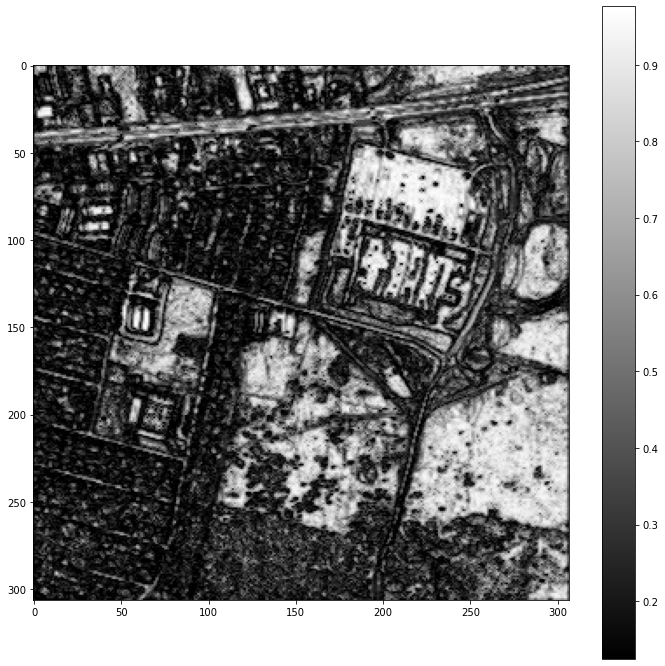

In [9]:
#Dictonary of aliases for datasets. The first string is the key and second is value (name of matfile without .mat suffix)
#Useful when looping over datasets
datasetnames = {
    "Urban": "Urban4",
}
dataset = "Urban"
hsi = load_HSI(
    datasetnames[dataset] + ".mat"
)
data,hmap = OutlierDetection(hsi.image,0.05,0.5).get_training_data()
plt.figure(figsize=(12,12))
plt.imshow(hmap,cmap='gray')
plt.colorbar()

## Set Hyperparameters

In [10]:
IsOutlierDetection = True

# Hyperparameters
num_endmembers = 4
num_spectra = 2000
batch_size = 15
learning_rate = 0.001
epochs = 13
n_bands = hsi.bands

opt = tf.optimizers.Adam(learning_rate=learning_rate)
activation = 'relu'
l1 = 1.0
osp = 0.5

# hsi.gt=None

if IsOutlierDetection:
    data,hmap = OutlierDetection(hsi.image,0.05,0.5).get_training_data()
    num_spectra = data.shape[0]
    batch_size = 256
else:
    data = hsi.array()

fid_scale = batch_size
loss = HyperLaplacianLoss(fid_scale).loss
    
# Hyperparameter dictionary
params = {
    "activation": activation,
    "num_endmembers": num_endmembers,
    "batch_size": batch_size,
    "num_spectra": num_spectra,
    "data": hsi,
    "epochs": epochs,
    "n_bands":n_bands ,
    "GT": hsi.gt,
    "lr": learning_rate,
    "optimizer": opt,
    "loss": loss,
    "scale": 1,
    "l1": l1,
    "osp": osp
}

training_data = data[
    np.random.randint(0, data.shape[0], num_spectra), :
]


## Train Autoencoder

SNR estimated = 28.43172981054703[dB]
... Select the projective proj.
Epoch 1/2
110/110 [==============================] - 2s 4ms/step - loss: 405.3877
Epoch 2/2
110/110 [==============================] - 1s 2ms/step - loss: 367.7413
Epoch 1/2
110/110 [==============================] - 1s 3ms/step - loss: 358.5475
Epoch 2/2
110/110 [==============================] - 1s 2ms/step - loss: 347.4530
Epoch 1/2
110/110 [==============================] - 1s 2ms/step - loss: 342.4487
Epoch 2/2
110/110 [==============================] - 1s 2ms/step - loss: 334.7614
Epoch 1/2
110/110 [==============================] - 1s 2ms/step - loss: 331.6654
Epoch 2/2
110/110 [==============================] - 1s 2ms/step - loss: 326.5654
Epoch 1/2
110/110 [==============================] - 1s 2ms/step - loss: 324.4462
Epoch 2/2
110/110 [==============================] - 1s 2ms/step - loss: 320.7900
Epoch 1/2
110/110 [==============================] - 1s 2ms/step - loss: 319.2872
Epoch 2/2
110/110 [=========

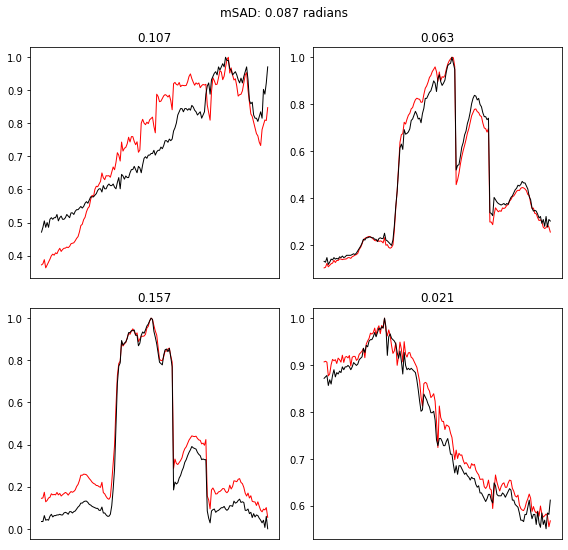

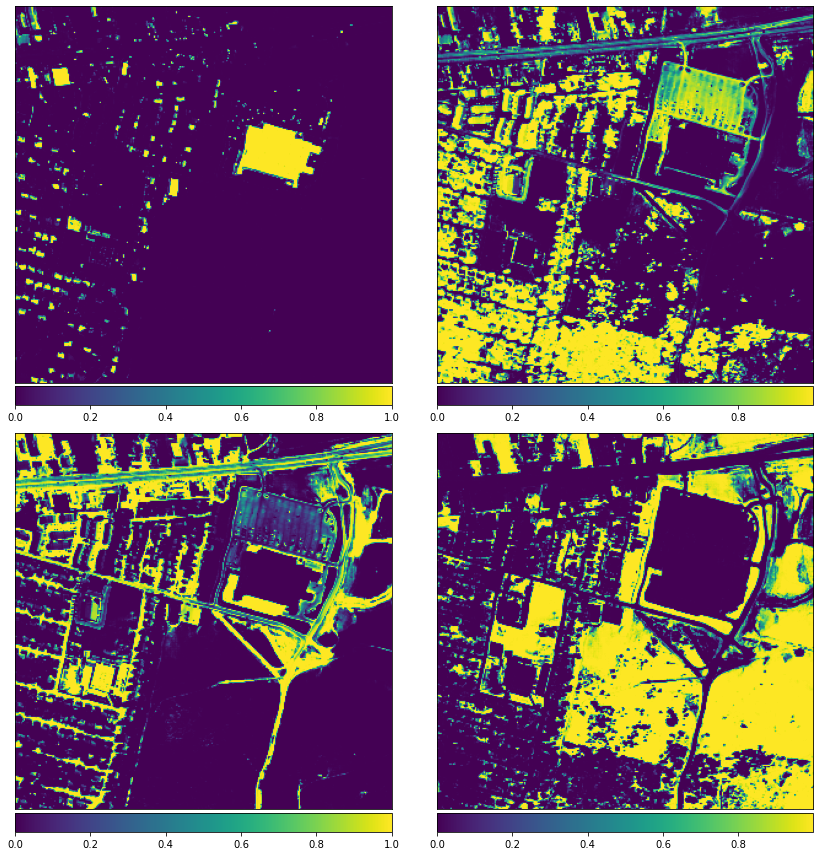

In [11]:
vca_end = vca(data.T,num_endmembers)[0]
autoencoder = Autoencoder(params,vca_end)
autoencoder.train_alternating(training_data,epochs)
endmembers = autoencoder.get_endmembers()
abundances = autoencoder.get_abundances()
plotEndmembersAndGT(endmembers, hsi.gt)
plotAbundancesSimple(abundances,'abund.png')


## Run experiment 

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 409.5637
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 364.5392
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 354.3937
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 343.8300
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 340.2650
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 332.3751
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 329.4798
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 324.0280
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 321.9108
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 316.9571
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 315.3817
Epoch 2/2
132/132 [========

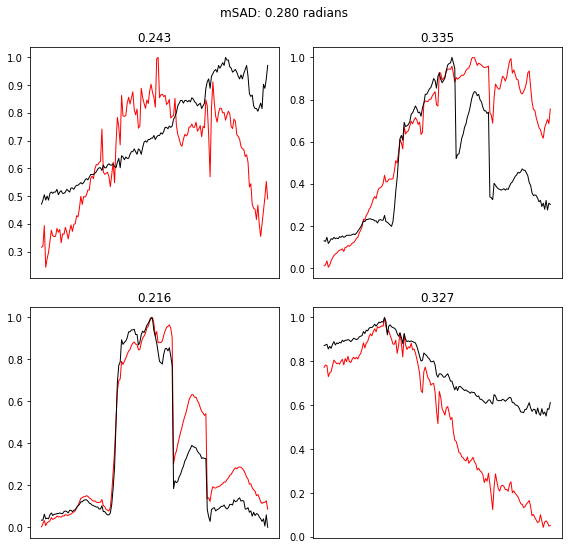

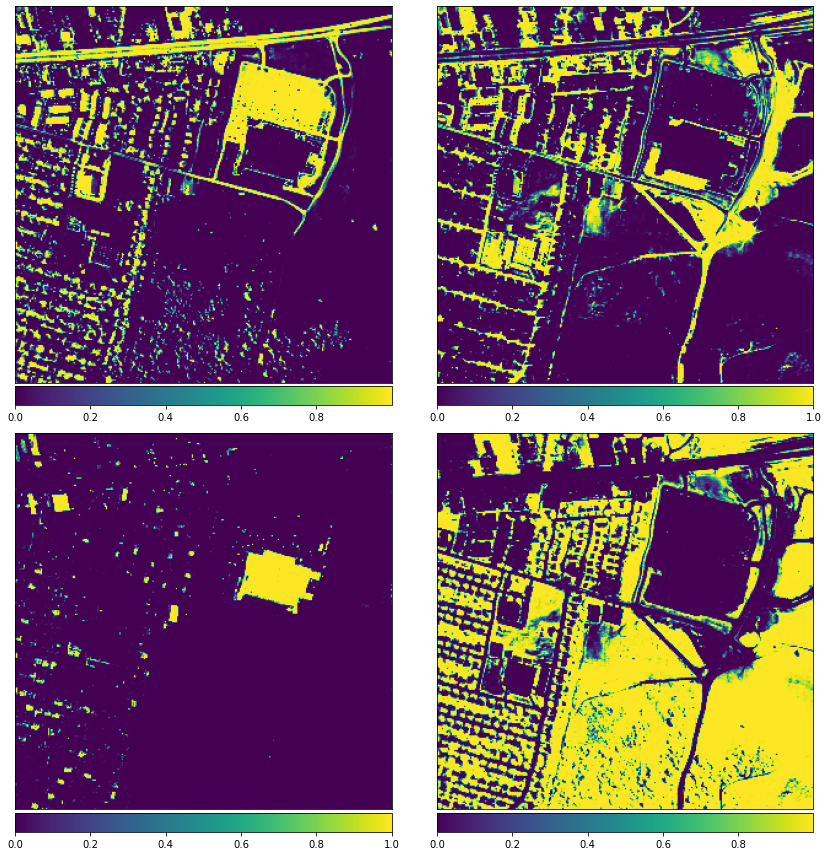

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 404.0813
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 360.6790
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 348.7162
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 337.2505
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 331.4000
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 323.3196
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 319.6895
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.1292
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 312.6965
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 309.4861
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 308.3029
Epoch 2/2
132/132 [========

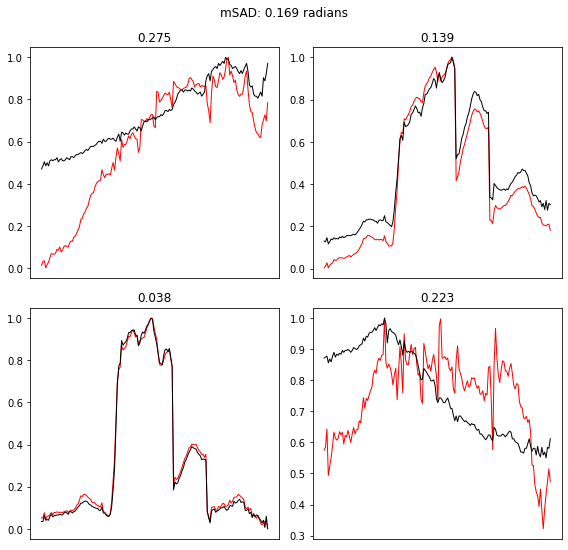

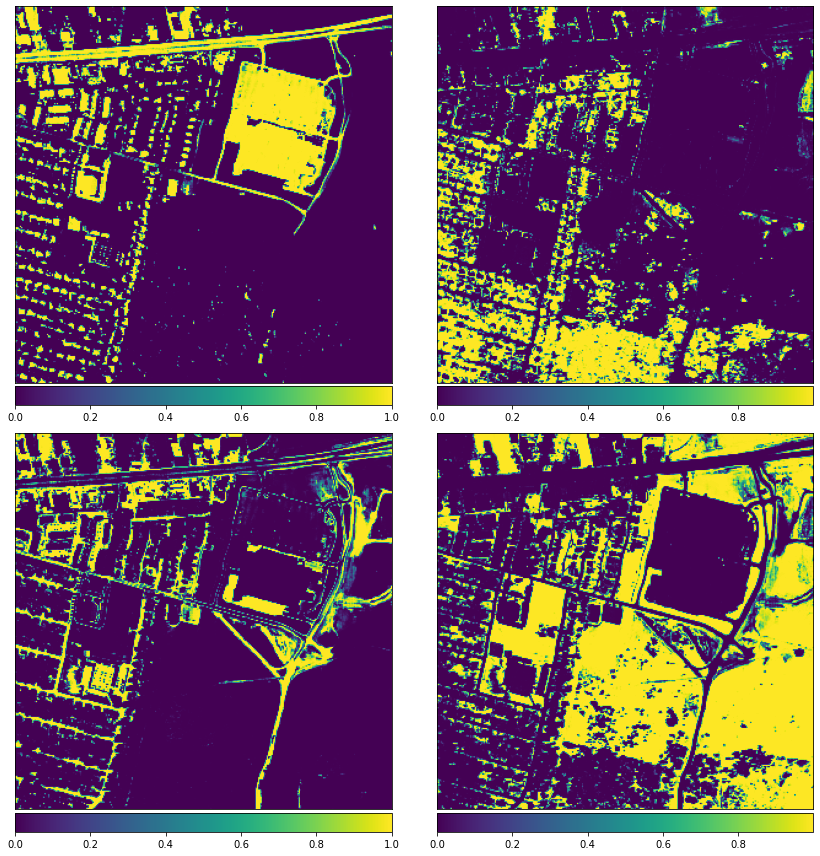

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 400.3449
Epoch 2/2
132/132 [==============================] - 1s 1ms/step - loss: 360.4771
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 350.2568
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 336.8738
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 331.2194
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 323.9128
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 320.9022
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 316.2836
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 314.7052
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 311.4770
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 310.2176
Epoch 2/2
132/132 [========

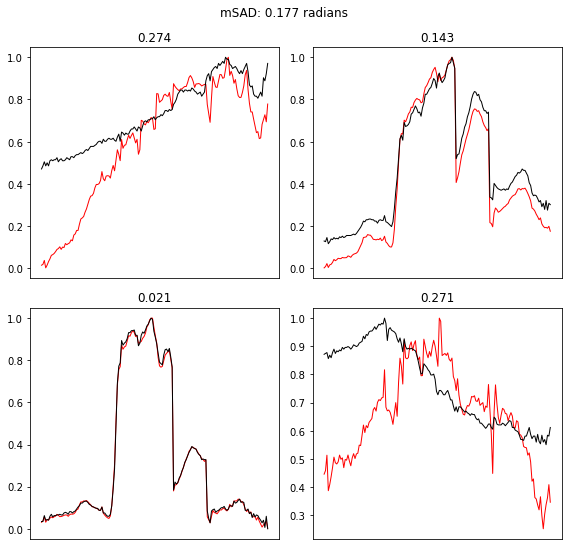

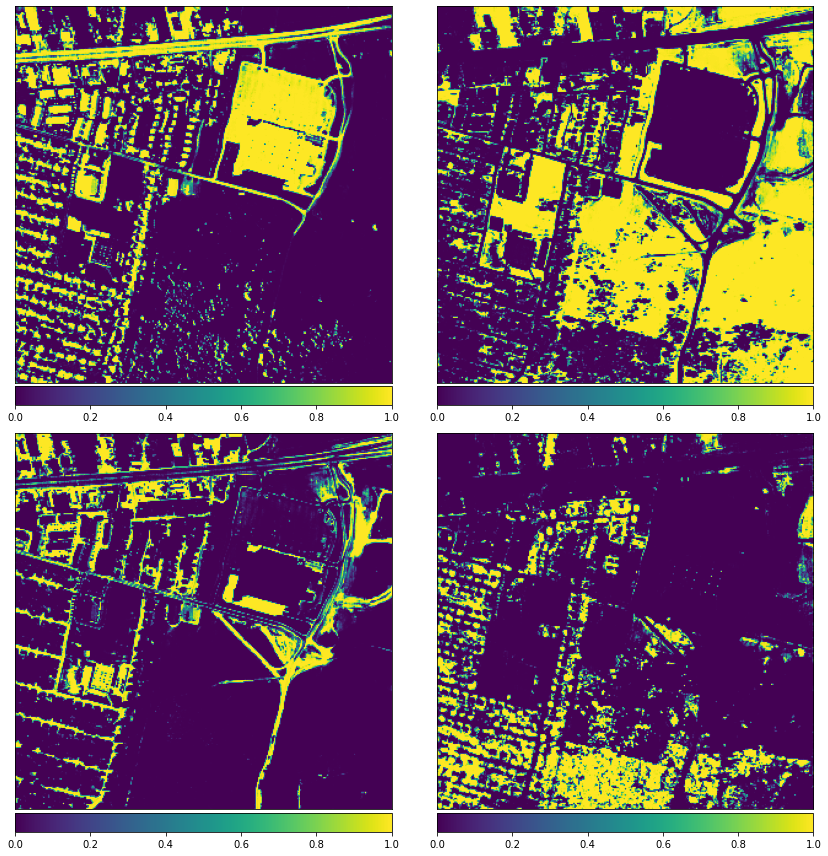

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 474.5336
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 383.3422
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 366.9640
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 349.9821
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 343.4228
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 335.4782
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 332.2640
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 326.4993
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 323.6086
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 319.1628
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 317.0071
Epoch 2/2
132/132 [========

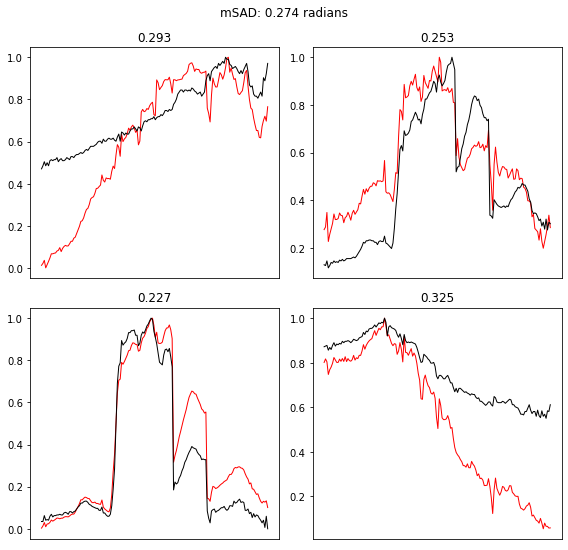

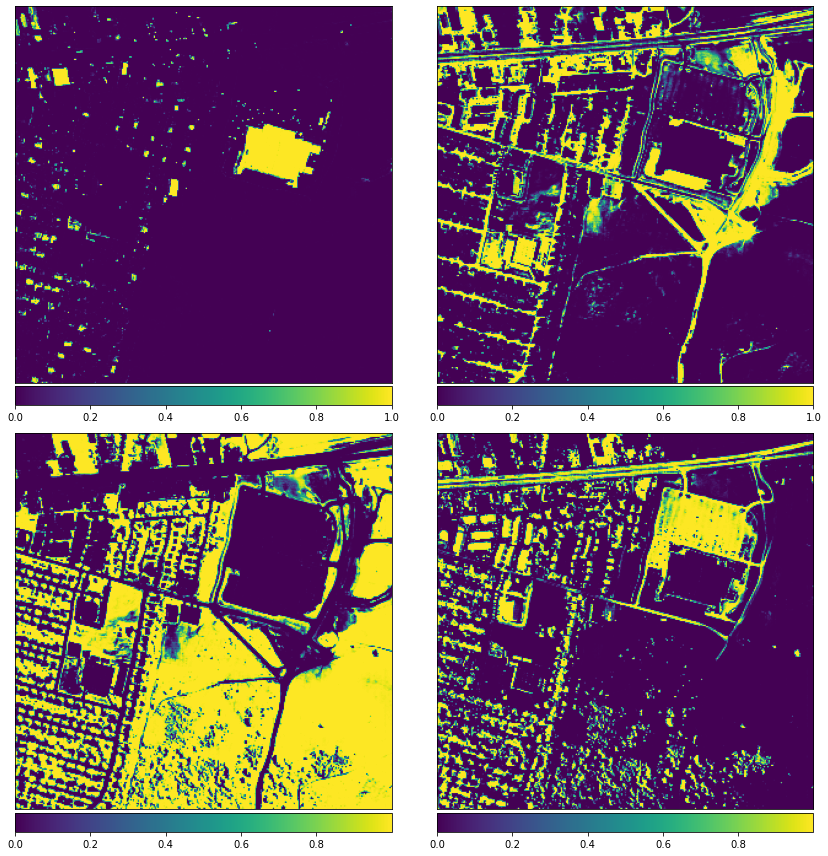

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 459.7239
Epoch 2/2
132/132 [==============================] - 2s 2ms/step - loss: 379.6738
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 362.0003
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 346.7887
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 340.5164
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 331.8740
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 328.1986
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 322.3160
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 319.7718
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.5497
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 313.8956
Epoch 2/2
132/132 [========

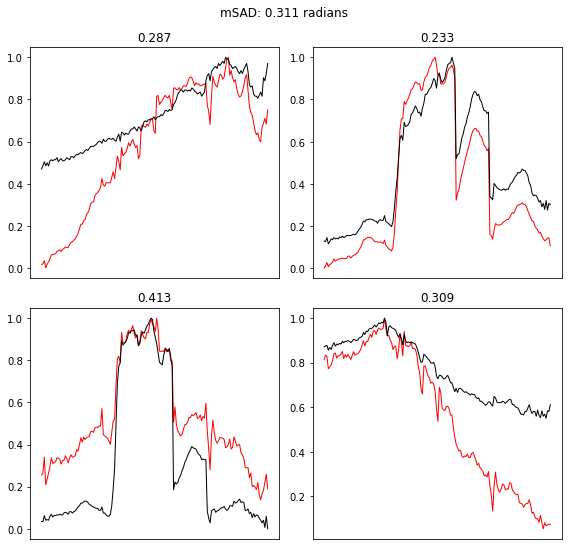

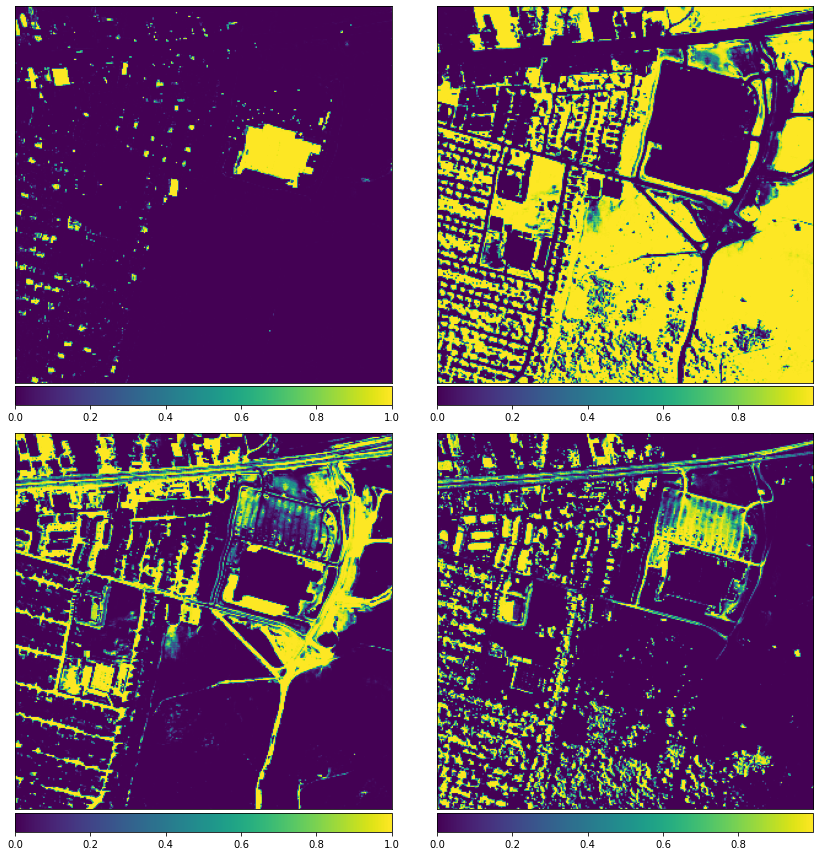

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 426.8376
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 365.9528
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 354.7884
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 343.8320
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 339.2125
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 331.4621
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 328.2873
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 322.1730
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 319.8782
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.5901
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 313.8426
Epoch 2/2
132/132 [========

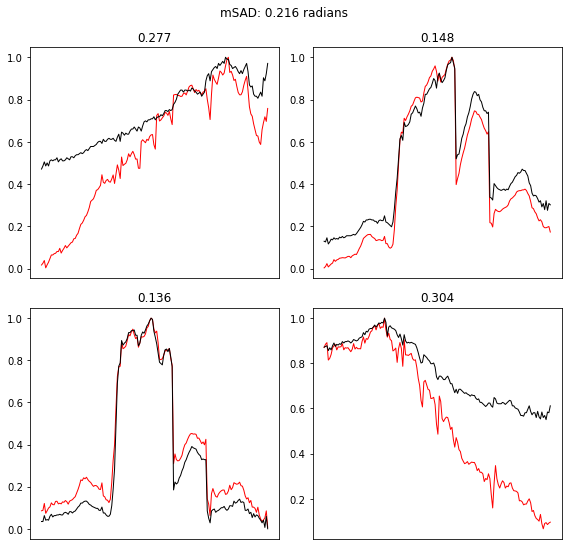

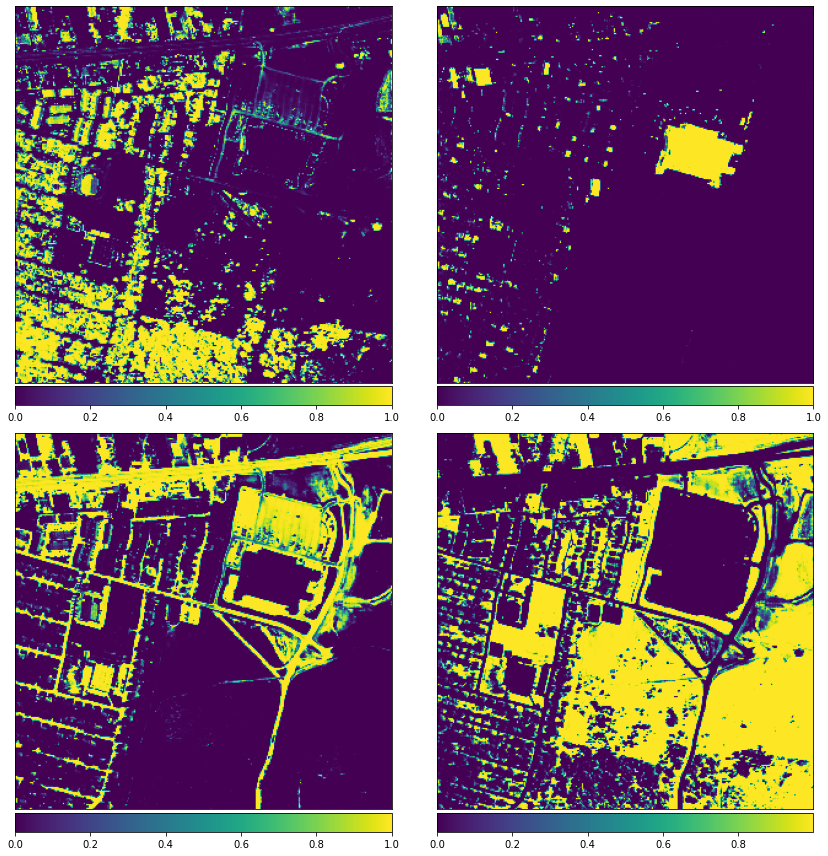

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 2ms/step - loss: 427.0844
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 366.0565
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 355.1146
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 344.1704
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 339.5811
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 331.5697
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 326.8255
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 321.2686
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 318.2249
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 314.5443
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 312.8326
Epoch 2/2
132/132 [========

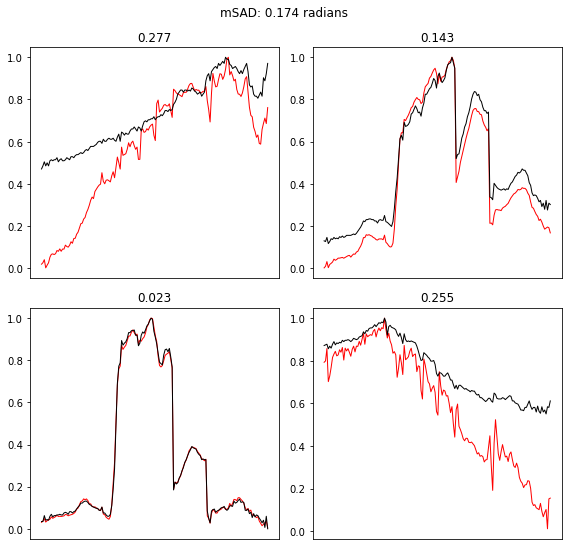

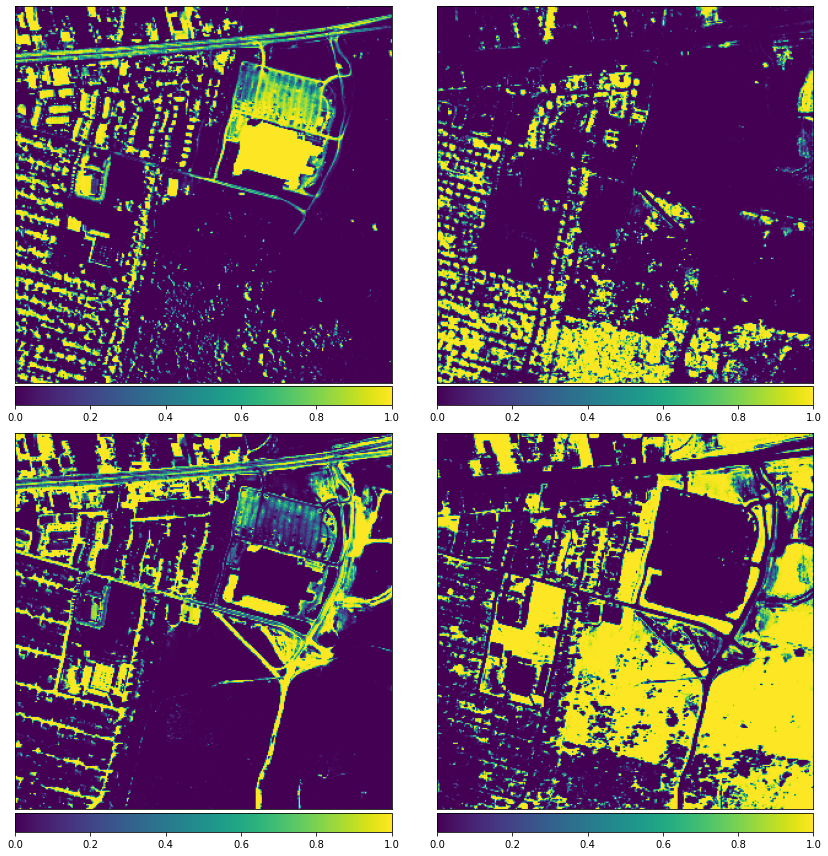

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 442.5470
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 372.8199
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 357.1997
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 345.5130
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 341.3592
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 333.1458
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 330.2754
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 325.4282
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 322.6783
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 318.5214
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 316.9084
Epoch 2/2
132/132 [========

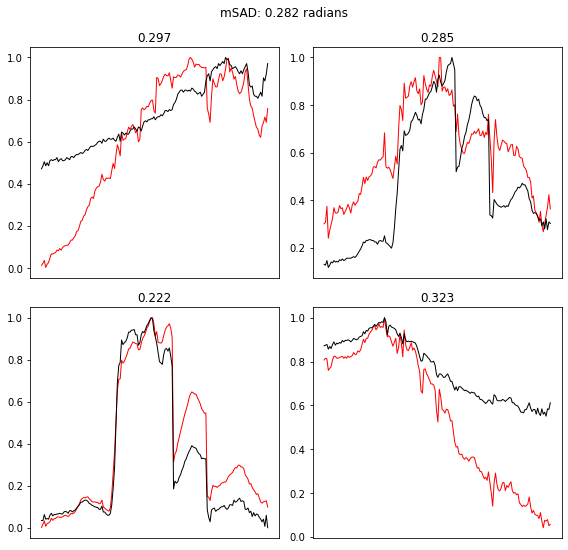

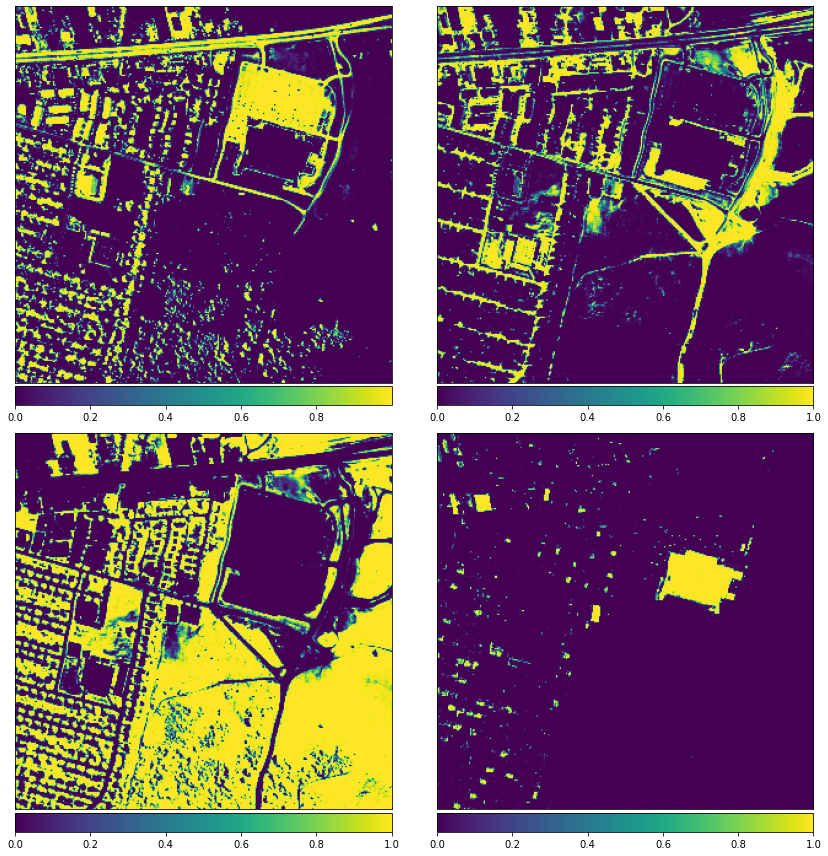

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 400.6382
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 360.9303
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 351.7390
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 338.8845
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 333.1369
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 325.3772
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 322.1891
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 318.1314
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 315.4180
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 312.3880
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 310.7573
Epoch 2/2
132/132 [========

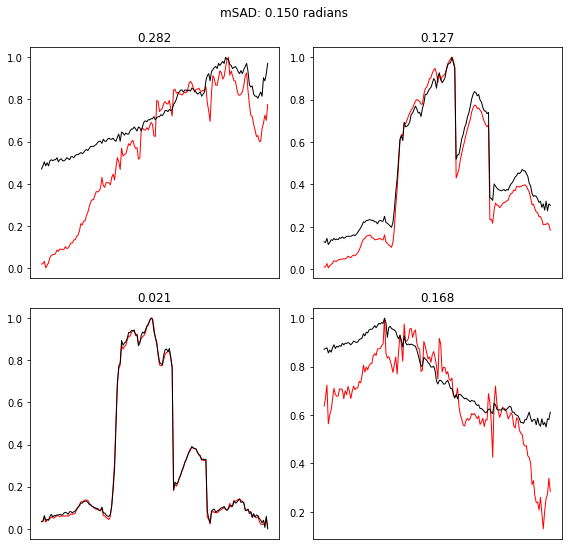

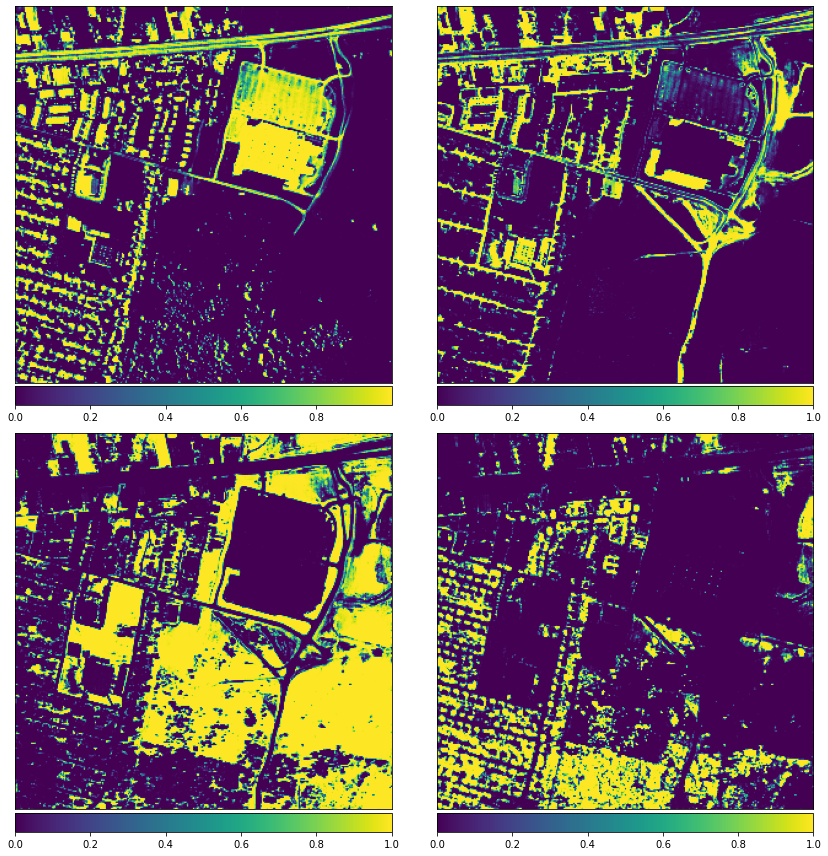

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 439.9798
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 371.9207
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 357.9392
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 346.4653
Epoch 1/2
132/132 [==============================] - 2s 2ms/step - loss: 340.6160
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 332.0321
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 328.8853
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 321.9836
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 319.5257
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.1077
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 313.5493
Epoch 2/2
132/132 [========

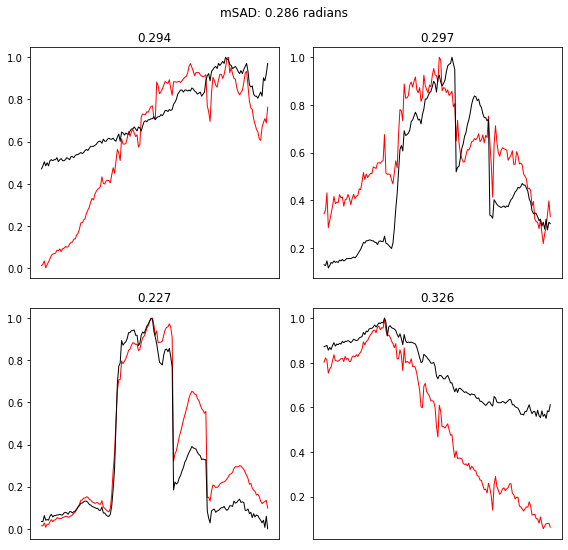

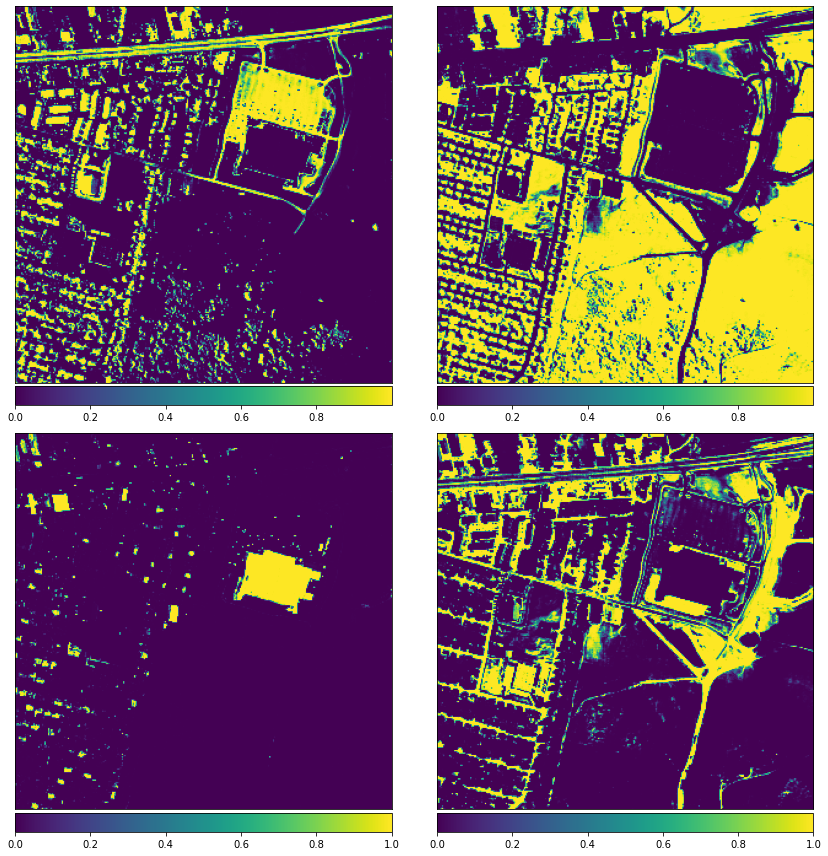

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 417.9175
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 368.3052
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 356.8423
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 344.9348
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 340.3587
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 333.3812
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 329.8425
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 324.0710
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 322.0800
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 317.7919
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 315.9338
Epoch 2/2
132/132 [========

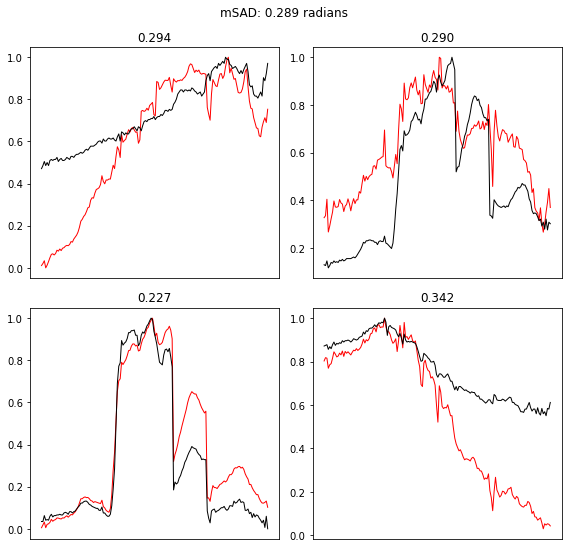

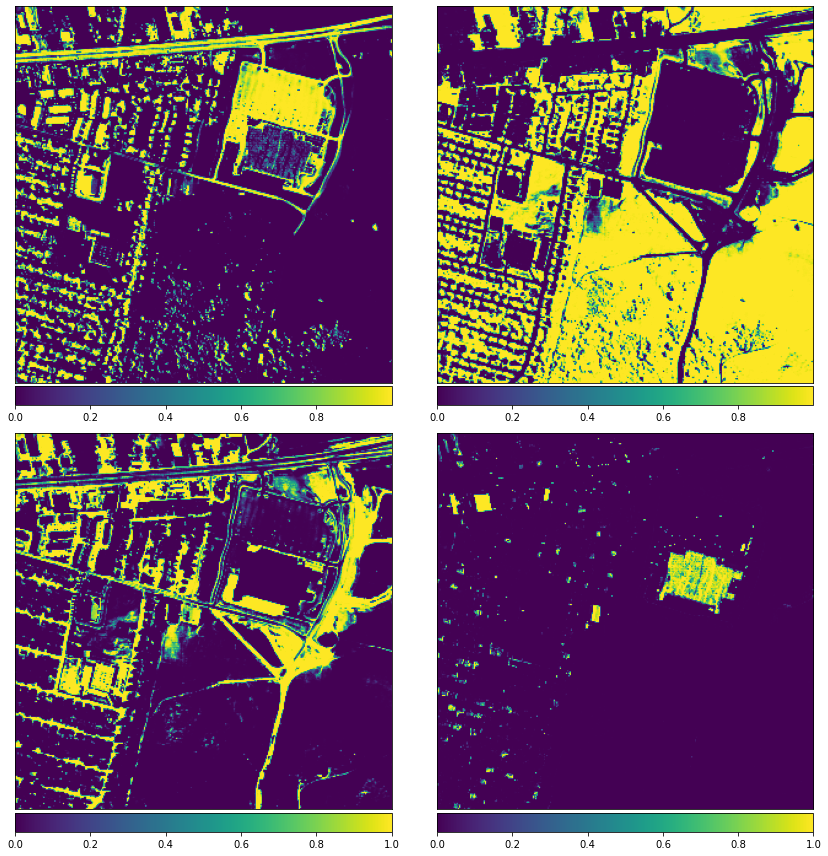

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 467.6474
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 383.6179
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 364.9031
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 347.7183
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 341.4023
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 333.2190
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 329.8070
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 323.6464
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 320.9043
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 316.2135
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 314.2312
Epoch 2/2
132/132 [========

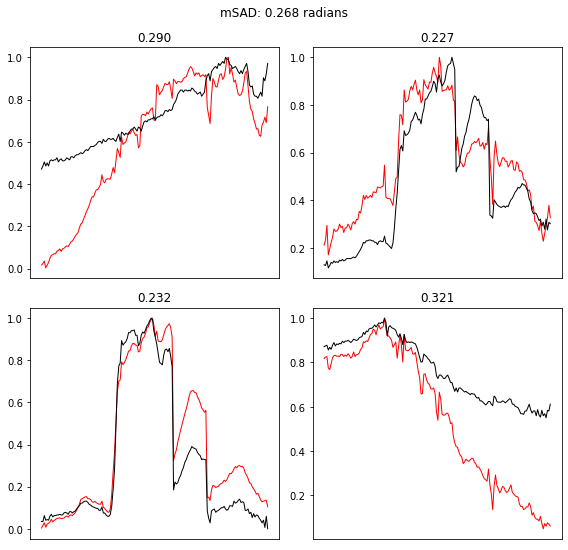

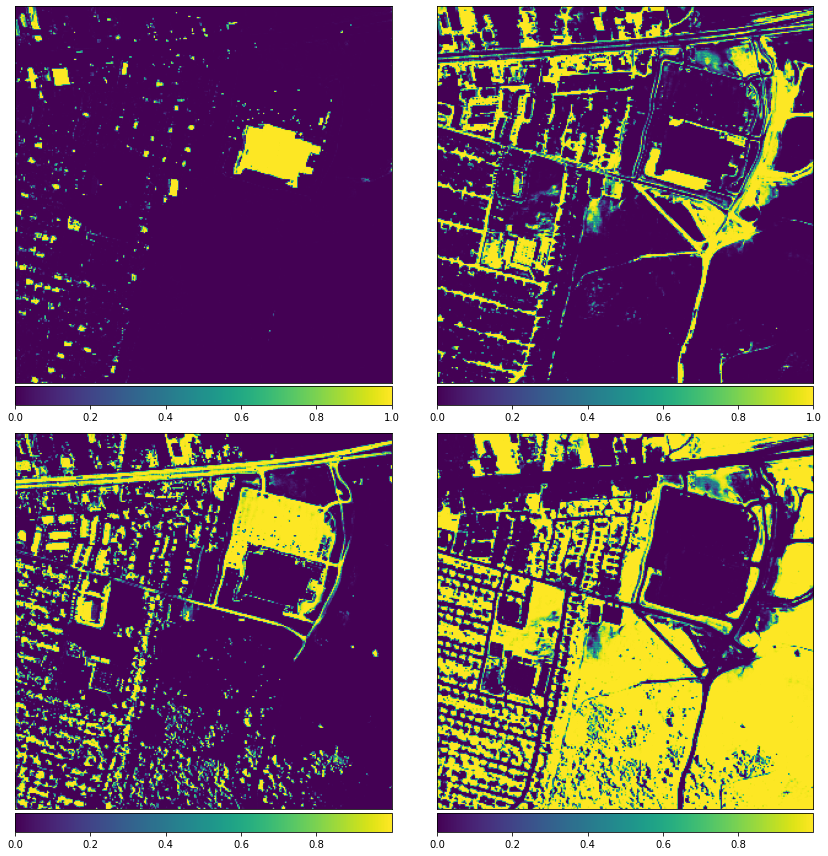

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 399.8126
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 360.2235
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 350.0618
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 337.8402
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 332.2684
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 324.5602
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 321.3458
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 316.6348
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 314.8285
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 311.7542
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 310.2201
Epoch 2/2
132/132 [========

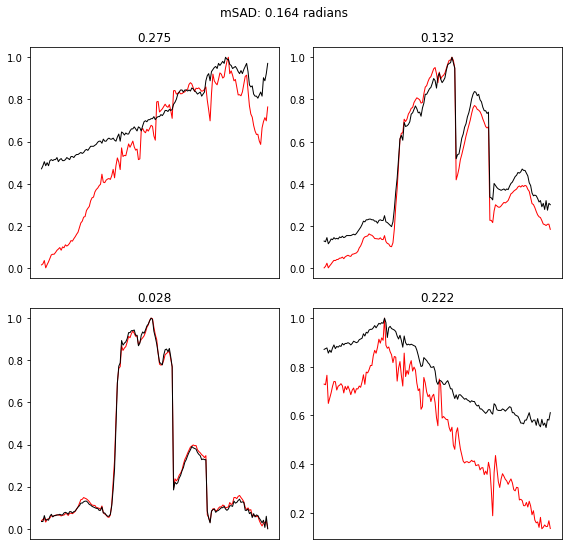

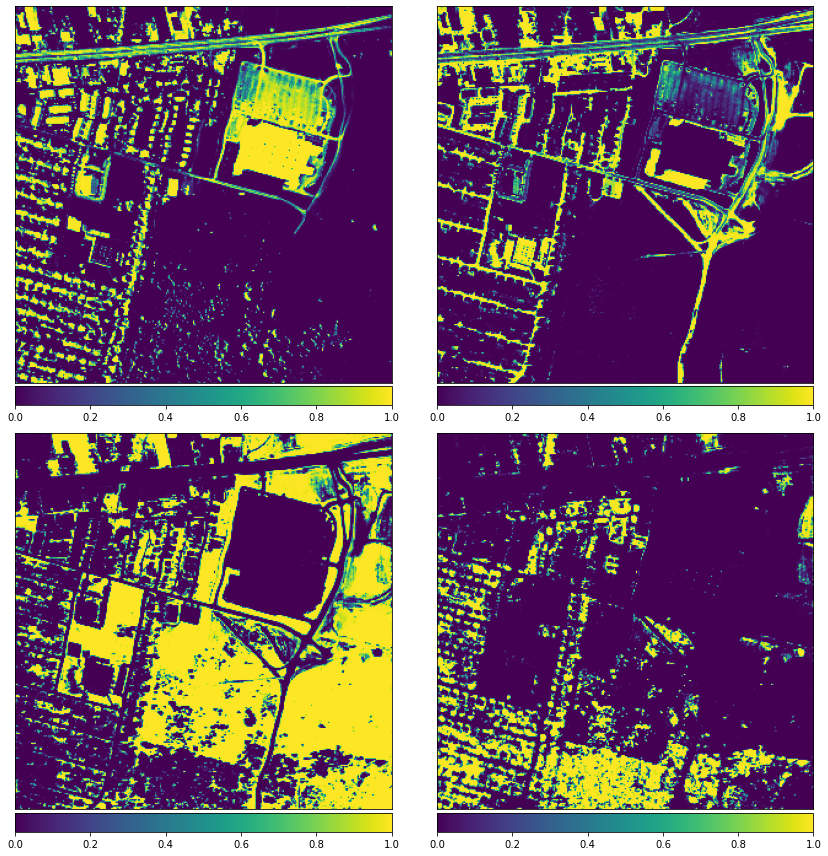

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 407.4431
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 362.0978
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 351.2524
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 339.3965
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 333.4060
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 325.1426
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 321.9319
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 317.1041
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 315.3883
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 312.3055
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 310.6075
Epoch 2/2
132/132 [========

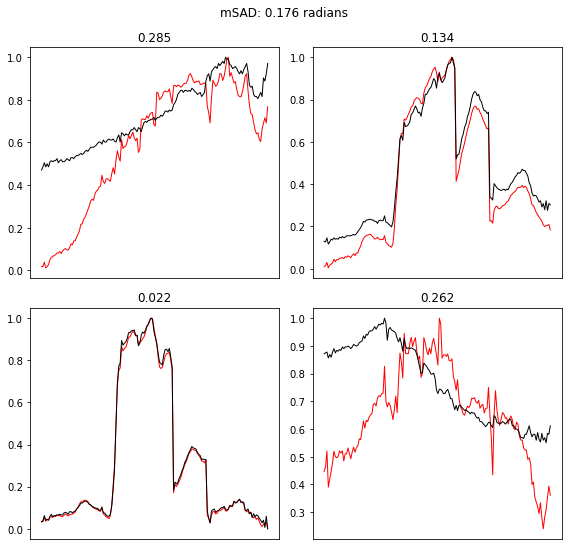

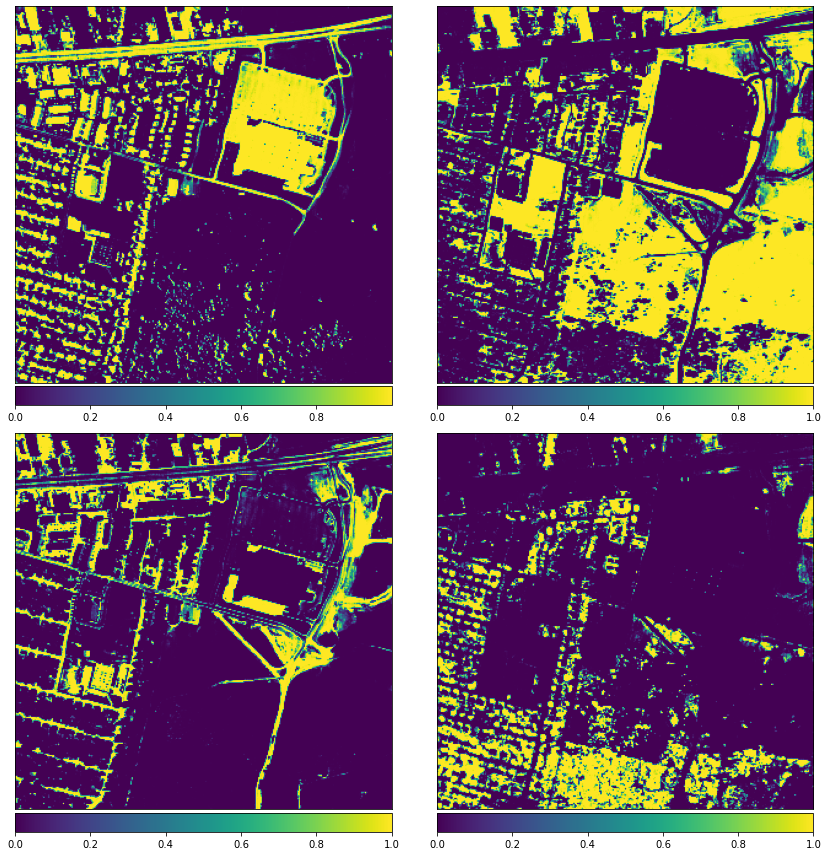

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 426.8184
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 365.8514
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 354.9378
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 344.0042
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 339.3763
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 331.4061
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 328.1357
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 322.2448
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 320.0490
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.8784
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 314.0727
Epoch 2/2
132/132 [========

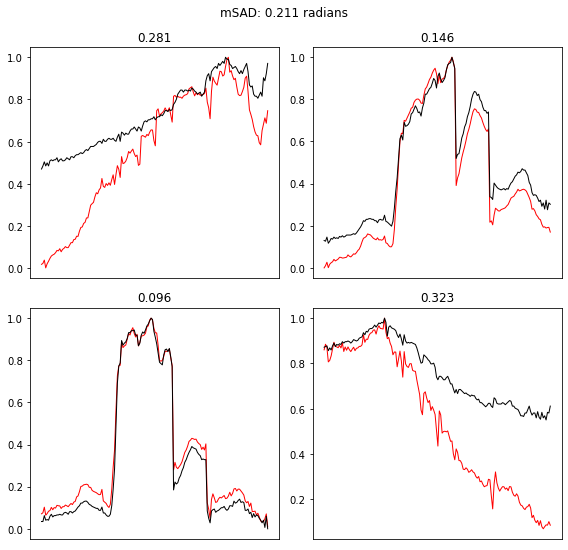

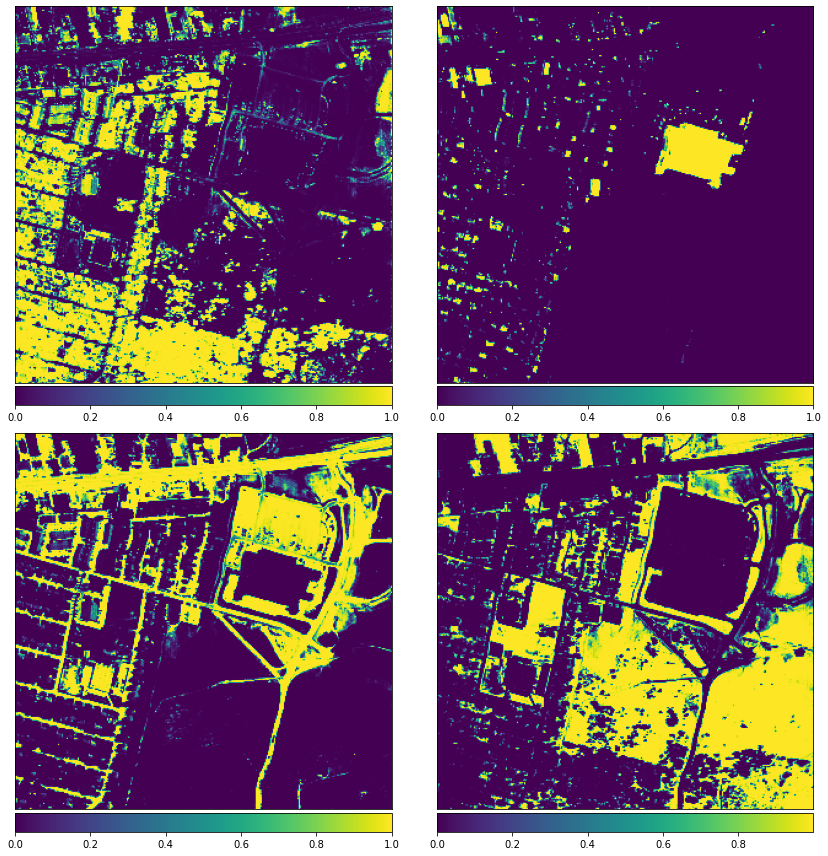

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 407.5041
Epoch 2/2
132/132 [==============================] - 2s 2ms/step - loss: 362.2857
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 350.4854
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 338.1446
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 333.0112
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 326.3431
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 323.4154
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 318.5191
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 316.4034
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 313.0117
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 311.5363
Epoch 2/2
132/132 [========

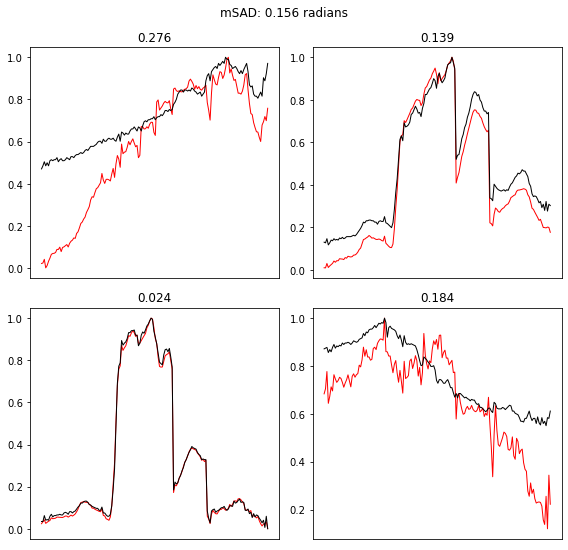

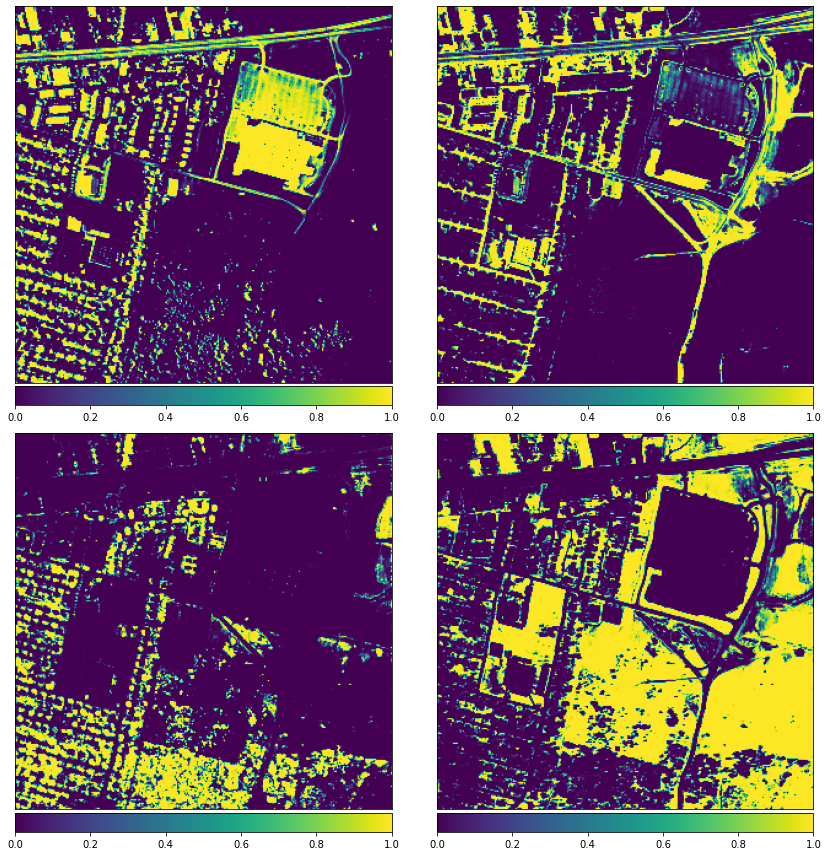

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 459.9058
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 379.2622
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 361.7087
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 346.1165
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 340.2349
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 331.6674
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 328.0894
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 322.1476
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 319.7150
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 315.4675
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 313.7592
Epoch 2/2
132/132 [========

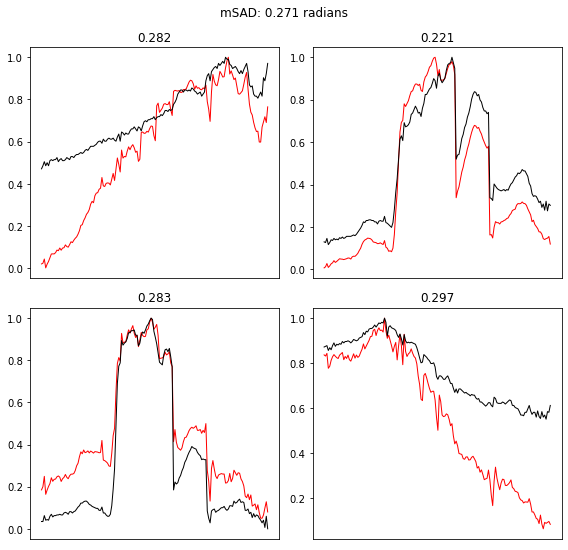

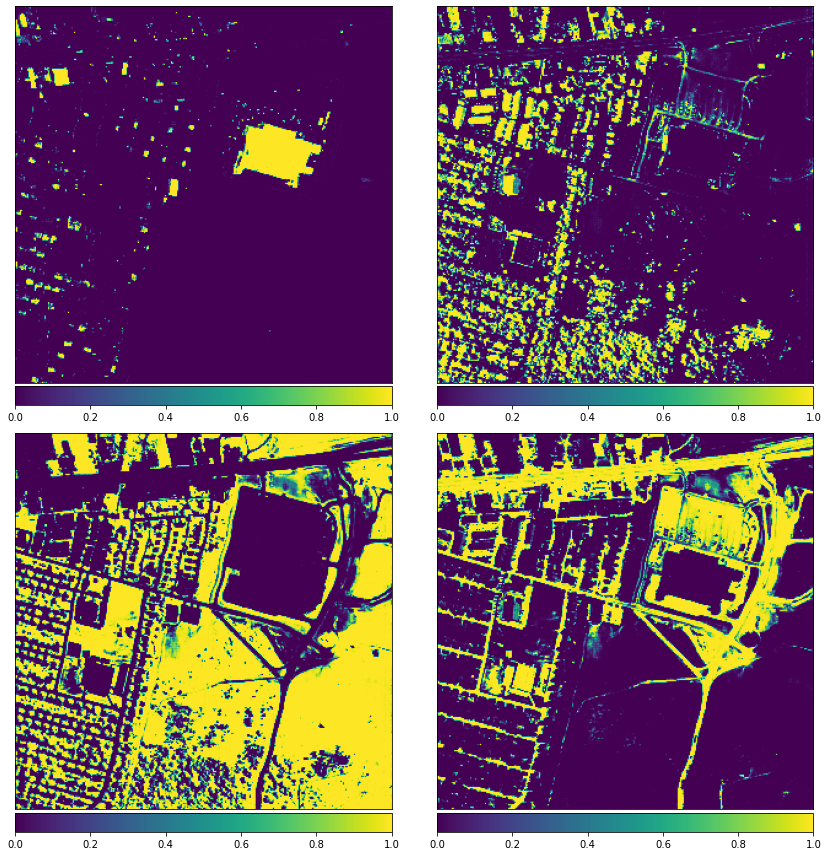

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 400.2896
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 359.7458
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 348.5160
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 335.3701
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 330.4046
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 323.3544
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 320.7156
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 316.3737
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 314.3571
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 311.6850
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 310.1075
Epoch 2/2
132/132 [========

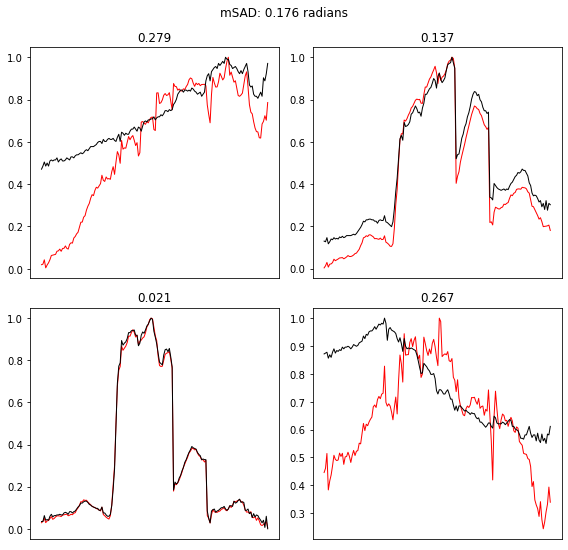

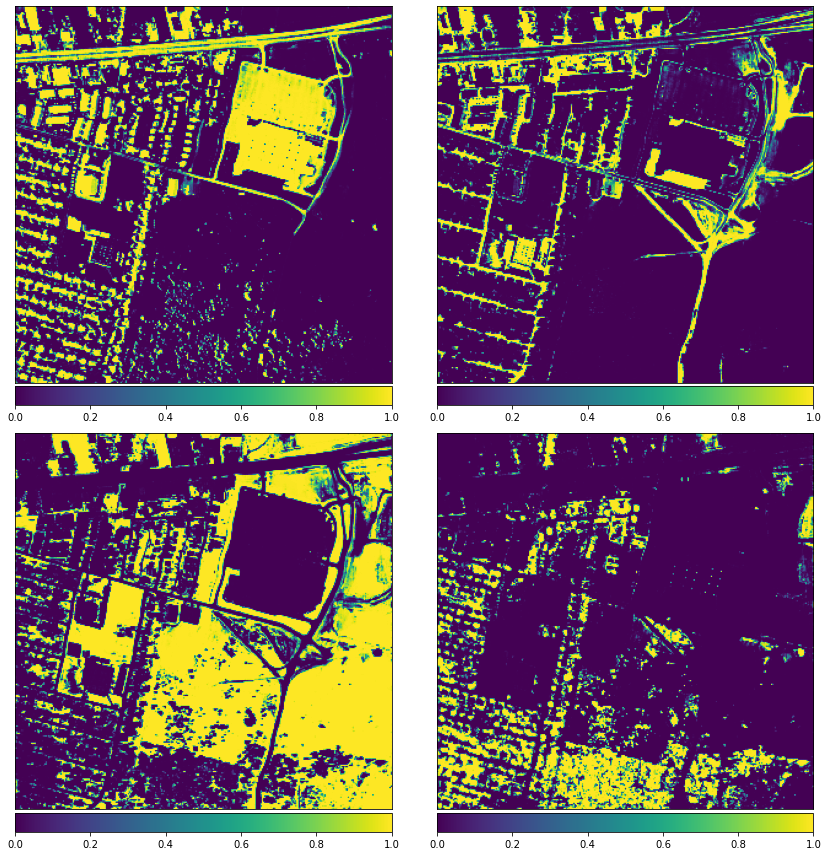

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 409.0974
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 363.7583
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 354.5088
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 344.1610
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 340.6646
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 332.1647
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 329.1040
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 323.7396
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 321.4893
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 317.8779
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 315.7851
Epoch 2/2
132/132 [========

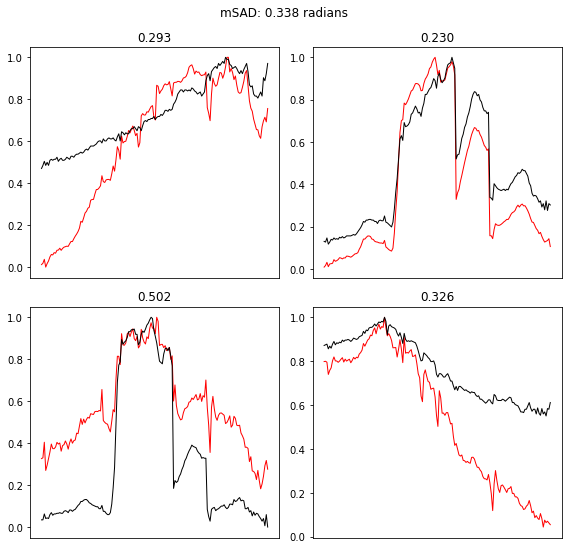

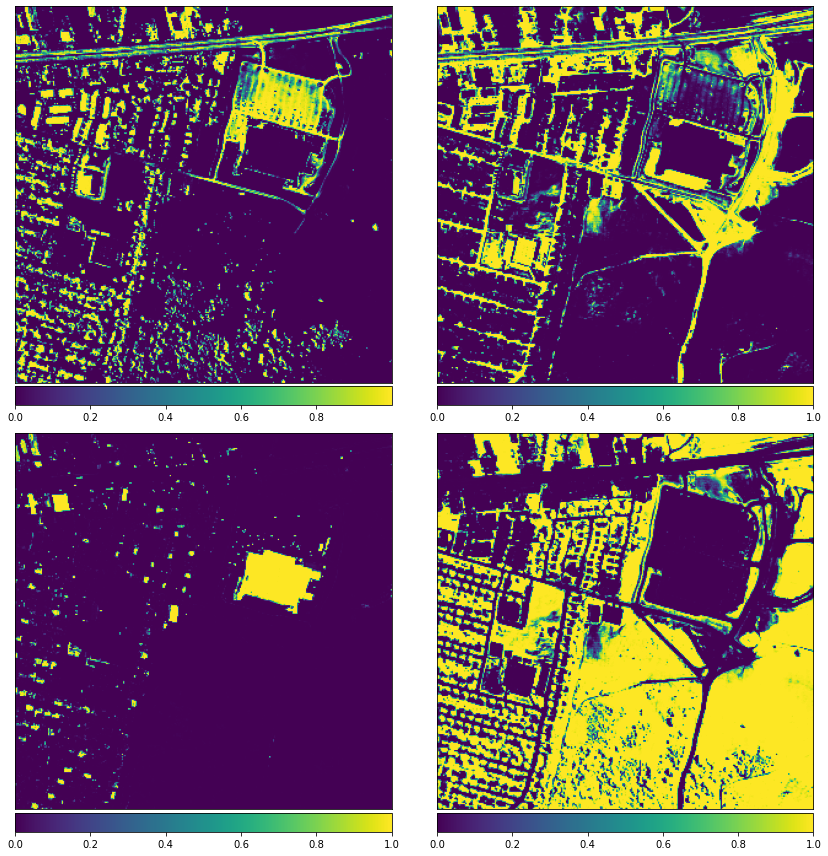

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 484.2791
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 382.6369
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 366.5732
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 352.0159
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 344.6713
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 336.4634
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 333.1403
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 327.1476
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 324.4269
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 319.5178
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 317.1521
Epoch 2/2
132/132 [========

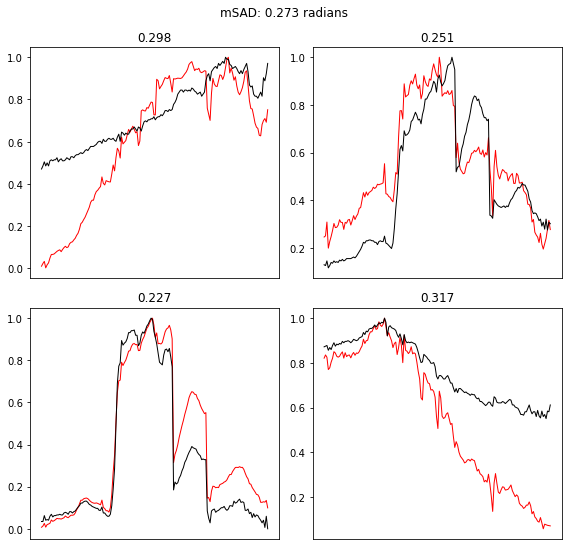

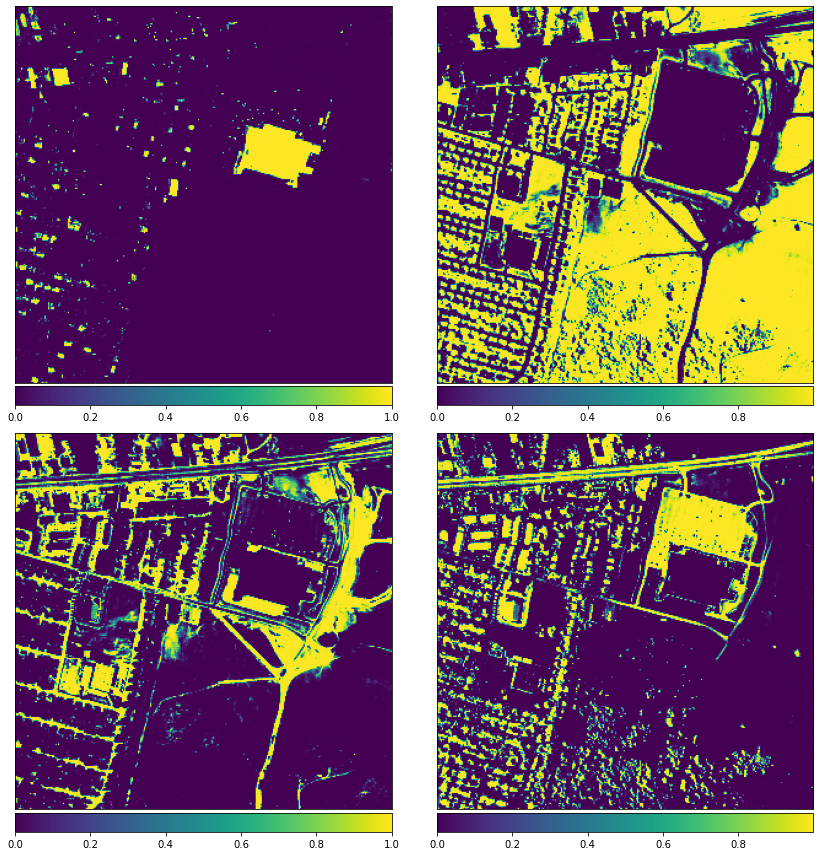

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 400.2287
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 360.5883
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 350.3354
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 337.7859
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 331.7277
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 324.4634
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 320.9778
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 316.5811
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 314.5371
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 311.2709
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 310.5105
Epoch 2/2
132/132 [========

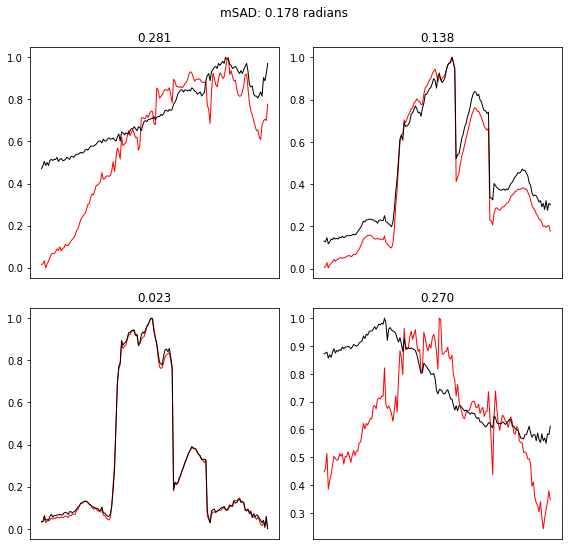

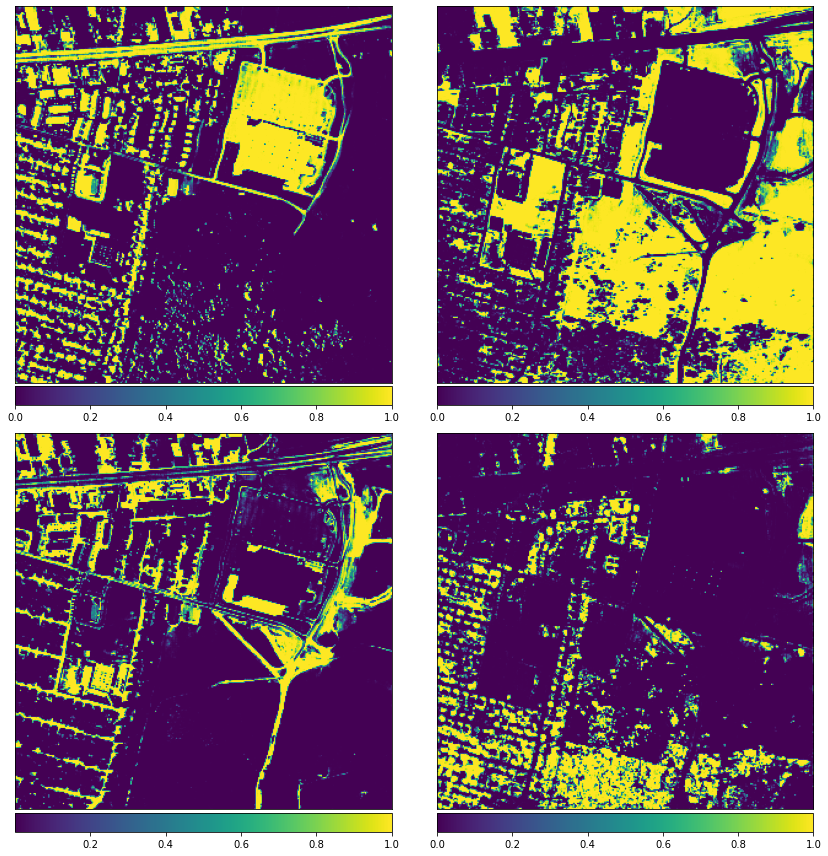

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 399.8693
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 360.2575
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 350.2167
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 337.8685
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 331.9394
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 324.1581
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 321.0547
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 316.1223
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 314.4849
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 311.1696
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 309.6834
Epoch 2/2
132/132 [========

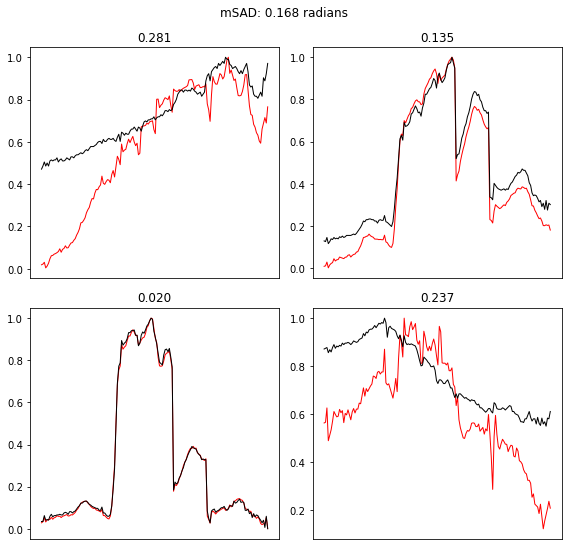

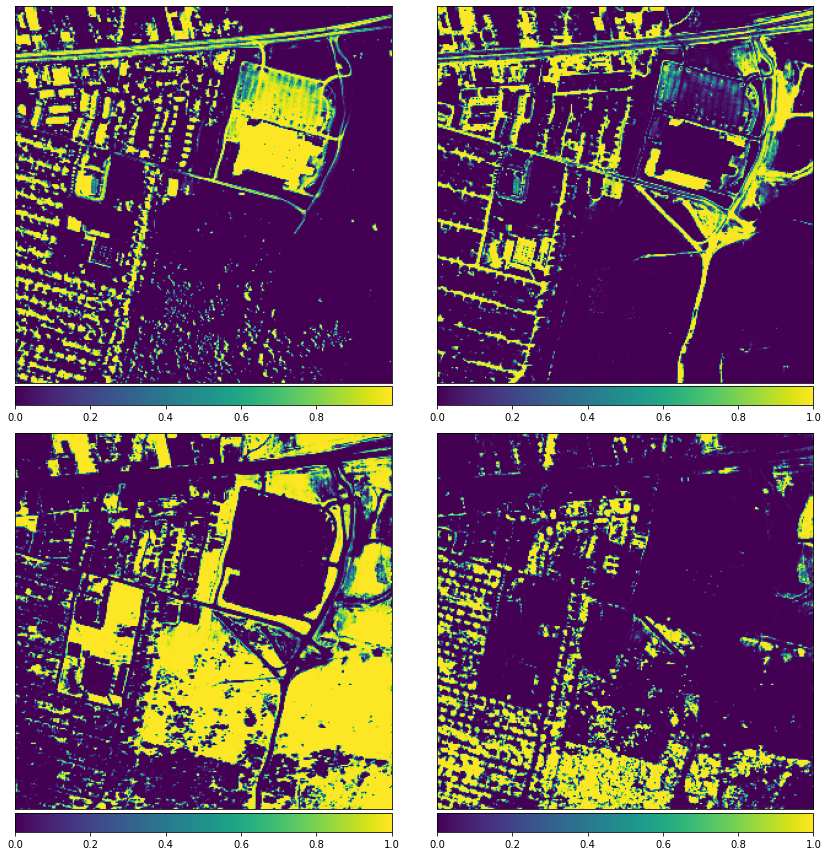

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 2s 2ms/step - loss: 430.8384
Epoch 2/2
132/132 [==============================] - 2s 2ms/step - loss: 366.9960
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 354.9116
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 343.2199
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 338.5890
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 330.5299
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 327.1109
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 321.4377
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 318.9346
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 314.5666
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 313.0620
Epoch 2/2
132/132 [========

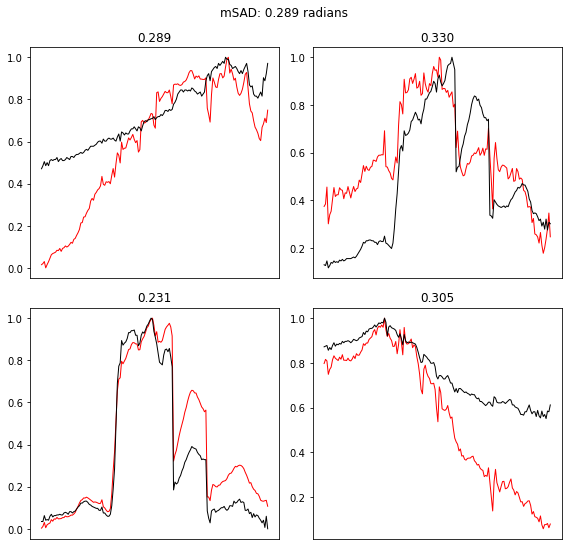

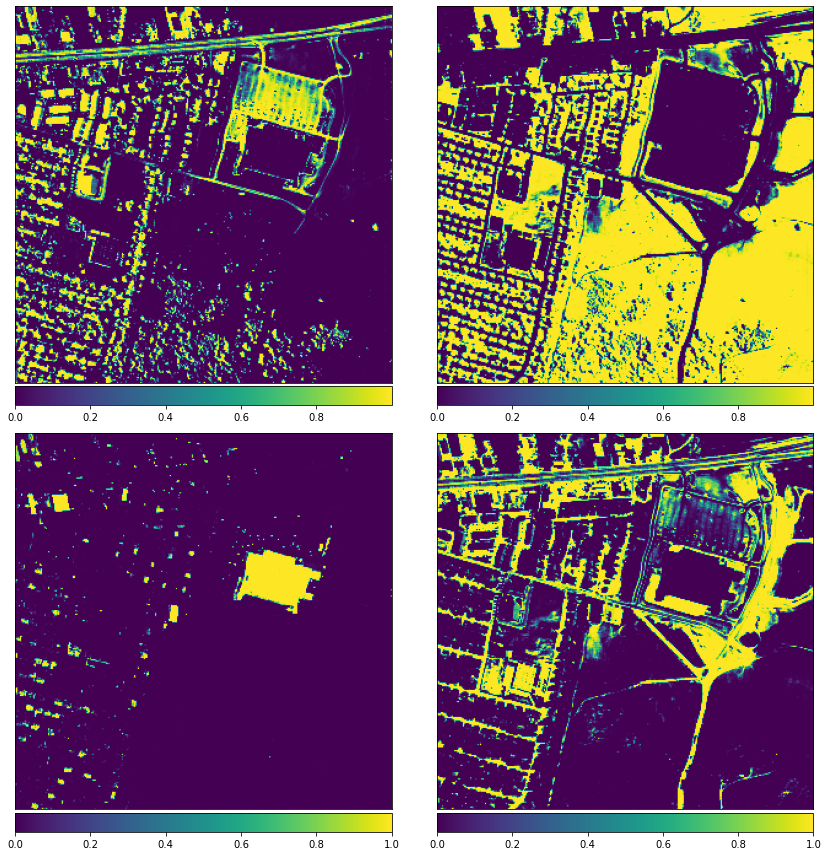

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 440.1917
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 372.4765
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 356.8605
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 344.4721
Epoch 1/2
132/132 [==============================] - 2s 3ms/step - loss: 340.5997
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 332.7648
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 330.0910
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 325.0202
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 322.4197
Epoch 2/2
132/132 [==============================] - 1s 3ms/step - loss: 318.8407
Epoch 1/2
132/132 [==============================] - 1s 3ms/step - loss: 316.4792
Epoch 2/2
132/132 [========

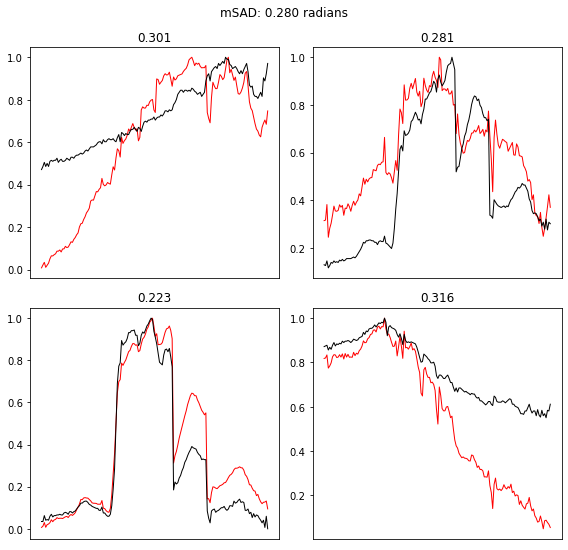

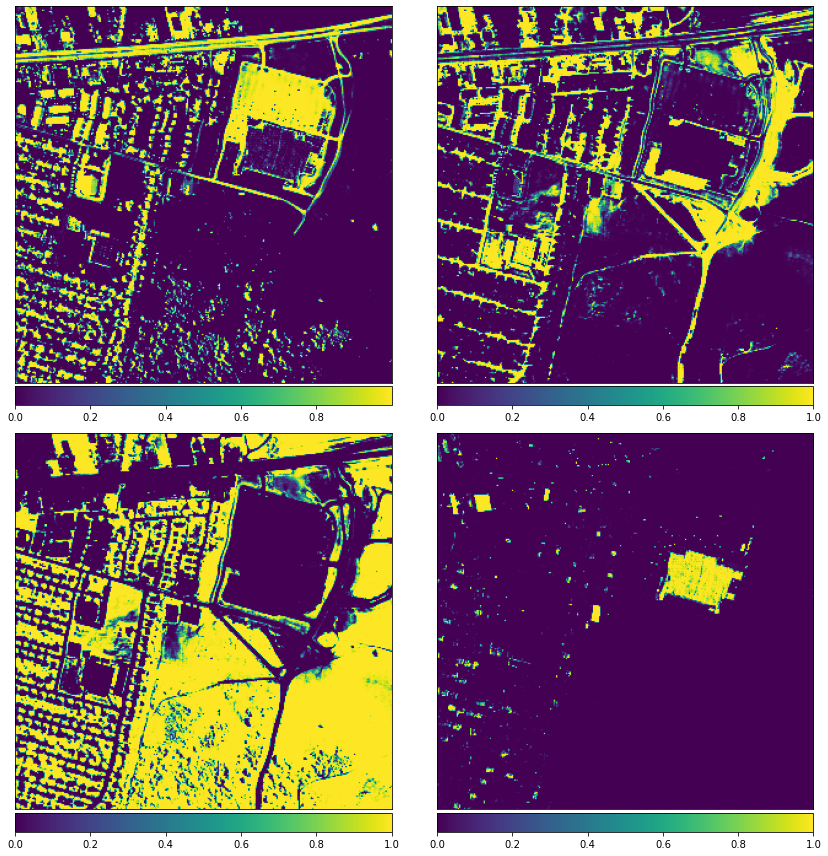

SNR estimated = 25.753884450571224[dB]
... Select the projective proj.
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 442.0568
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 373.1873
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 357.0170
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 345.6726
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 340.6134
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 334.6270
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 330.6493
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 325.2652
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 322.8260
Epoch 2/2
132/132 [==============================] - 1s 2ms/step - loss: 318.3900
Epoch 1/2
132/132 [==============================] - 1s 2ms/step - loss: 317.0110
Epoch 2/2
132/132 [========

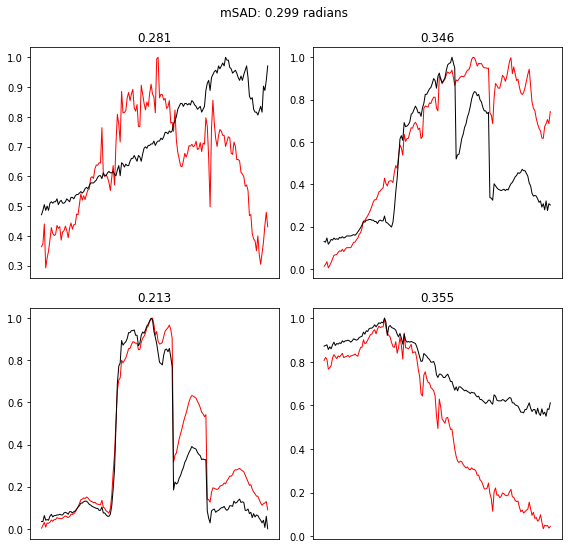

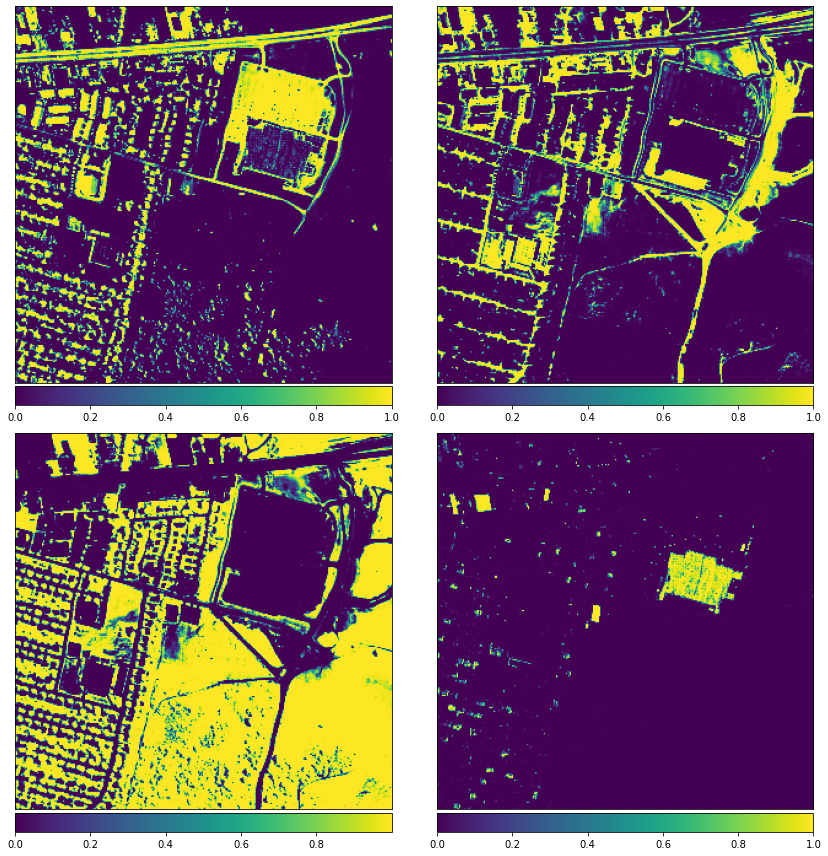

In [12]:
num_runs = 25
results_folder = './Results5'
method_name = 'OSPAEU'

#Dictonary of aliases for datasets. The first string is the key and second is value (name of matfile without .mat suffix)
#Useful when looping over datasets
datasetnames = {"Urban":"Urban4"}

for dataset in ['Urban']:
    save_folder = results_folder+'/'+method_name+'/'+dataset
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)
    dataset_name = dataset

    hsi = load_HSI(
 datasetnames[dataset] + ".mat"
    )
    hsi.image = hsi.image-np.min(hsi.image,axis=2,keepdims=True)+ 0.000001 #negative values cause trouble
    data,hmap = OutlierDetection(hsi.image,0.05,0.5).get_training_data()
    
    num_spectra = data.shape[0]
    batch_size = 256
    params['num_spectra']=num_spectra
    params['data']=hsi
    params['n_bands']=hsi.bands

    for run in range(1,num_runs+1):
        opt = tf.optimizers.Adam(learning_rate=learning_rate)
        params['optimizer']=opt
        training_data = data[np.random.randint(0, data.shape[0], num_spectra), :]
        save_name = dataset+'_run'+str(run)+'.mat'
        save_path = save_folder+'/'+save_name
        vca_end = vca(data.T,num_endmembers)[0]
        autoencoder = Autoencoder(params,vca_end)
        autoencoder.train_alternating(training_data,epochs)
        endmembers = autoencoder.get_endmembers()
        abundances = autoencoder.get_abundances()
        plotEndmembersAndGT(endmembers, hsi.gt)
        plotAbundancesSimple(abundances,'abund.png')
        sio.savemat(save_path,{'M':endmembers,'A':abundances})
 